In [1]:
import os

from tqdm import tqdm

import itertools
import warnings
warnings.filterwarnings('ignore')

from matplotlib import gridspec
import matplotlib.dates as mdates
from matplotlib.dates import DateFormatter
import matplotlib.dates as mdates
from matplotlib import cm
import matplotlib.ticker as mtick
from matplotlib.ticker import MaxNLocator


import datetime
from scipy import stats
from scipy.stats import pearsonr
import statsmodels.api as sm

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
data_path = '/Users/reneprincipe/Library/CloudStorage/GoogleDrive-rlprincipe@up.edu.ph/My Drive/Research - PhD/Results/Resettlements/Resettlement Black Marble NTL Values/' 

In [3]:
start_date, end_date = "2012-01-01", "2024-01-28"
date_range = pd.date_range(start=start_date, end=end_date, freq='D')

In [4]:
files = [f for f in os.listdir(data_path) if not f.startswith('.')]
files.sort()
files

['NTL_Resettlement_Sites_0.csv',
 'NTL_Resettlement_Sites_1.csv',
 'NTL_Resettlement_Sites_2.csv',
 'NTL_Resettlement_Sites_3.csv',
 'NTL_Resettlement_Sites_4.csv',
 'NTL_Resettlement_Sites_5.csv']

# Test Plots

In [5]:
NTL_data = pd.read_csv(data_path+files[0], parse_dates=True, index_col = 0)*10#.reset_index(drop=True)*10
NTL_data.astype(float)

,Maya Park,Lanao Unity Park,Daanbantayan 3,Daanbantayan 4,Daanbantayan Site 1,Daanbantayan Site 2,Olivo Heights,Northview Park,Northview Park 2,Lawis Residences,...,Carigara Housing Project 1,Ecoville,Vergabriel's Heights,Mayorga Towne Homes,Paglaum Ville,Mont Eagle Ville IV,Tolosa Haiyan Village,Matlang Heights,Coconut Grove,Bagong Pag-Asa
2012-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-01-24,18.637931,2.035714,2.208333,0.0,7.000000,0.000000,0.000000,0.000000,0.000000,8.719577,...,16.0,5.489796,5.793893,0.0,3.0,0.000000,7.480916,15.341969,0.0,8.424138
2024-01-25,19.293103,21.130952,4.435185,6.0,3.000000,16.521739,4.296296,5.182857,2.956522,7.000000,...,13.0,10.061224,2.320611,2.0,3.0,1.574219,5.076336,27.575130,3.0,9.724138
2024-01-26,19.293103,21.130952,4.435185,6.0,3.000000,16.521739,4.296296,5.182857,2.956522,7.000000,...,13.0,10.061224,2.320611,2.0,3.0,1.574219,5.076336,27.575130,3.0,9.724138
2024-01-27,30.448276,7.952381,8.851852,11.0,11.168675,4.123188,4.296296,5.182857,4.217391,10.211640,...,13.0,10.061224,2.320611,2.0,3.0,5.128906,5.076336,14.611399,3.0,9.724138


## formatter functions

In [6]:
def format_dates():
    dtFmt = mdates.DateFormatter("%b-%Y") # define the formatting
    ax.xaxis.set_major_formatter(dtFmt) # apply the format to the desired axis
    plt.gcf().autofmt_xdate
    
def show_legend():    
    ax.set_ylabel('NTL Radiance, $nW·cm^{−2}·sr^{−1}$')
    ax.grid(alpha = 0.4)
    plt.legend(fontsize=10, ncol = 3, bbox_to_anchor= (0, 1.05, 1, 0.5), loc="lower left",
                    bbox_transform=plt.gca().transAxes, fancybox = True, mode='expand')

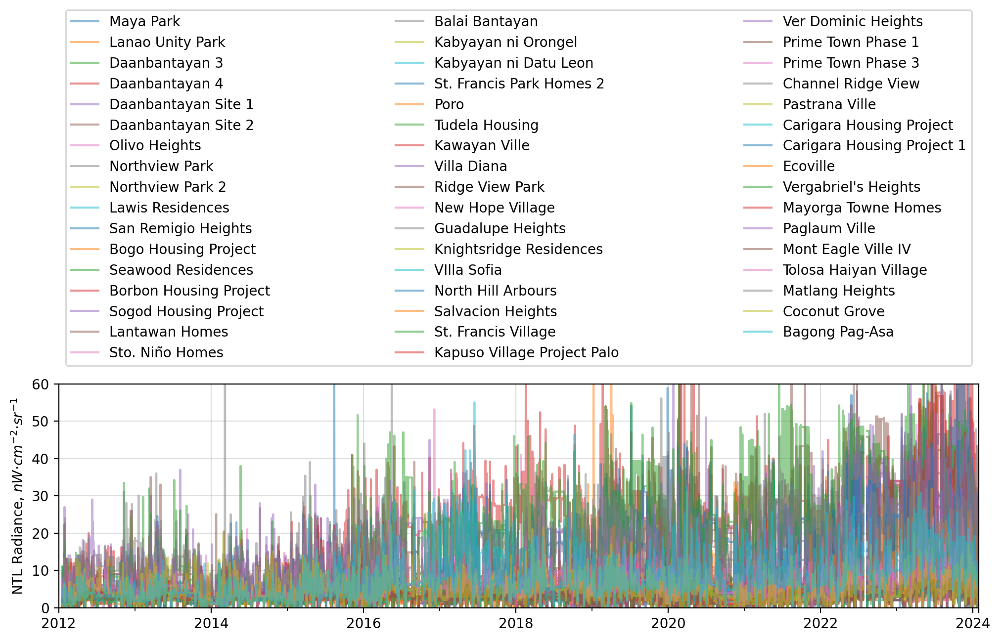

In [7]:
fig, ax = plt.subplots(dpi = 200, figsize = (12,3))
fig.patch.set_facecolor('None')

NTL_data.plot(ax=ax, alpha = 0.5)
show_legend()
plt.ylim(0,60)
plt.show()

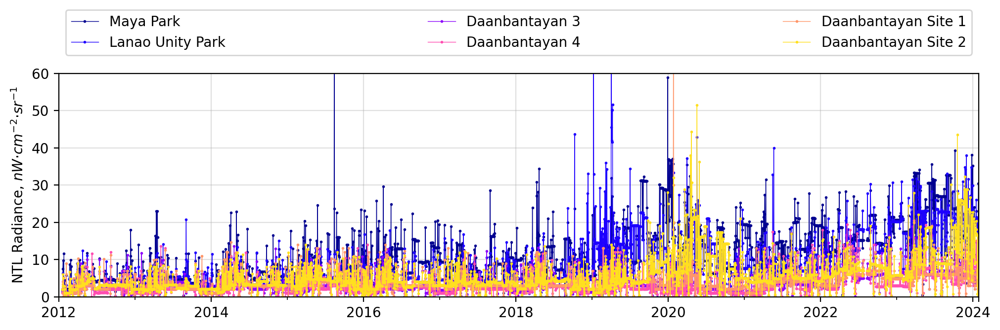

In [8]:
NTL_test = NTL_data[NTL_data.columns[:6]]
palette = sns.color_palette('gnuplot2', len(NTL_test.columns))


fig, ax = plt.subplots(dpi = 200, figsize = (12,3))
fig.patch.set_facecolor('None')

NTL_test.plot(ax=ax, marker='o', markersize=1, linestyle='-', linewidth=0.5, color = palette)
ax.set_ylabel('NTL Radiance, $nW·cm^{−2}·sr^{−1}$')
show_legend()
plt.ylim(0,60)
plt.show()

## quantile filtering

In [9]:
def outlier_removal(dataframe):
    q_low = dataframe.quantile(0.05)
    q_hi  = dataframe.quantile(0.95)
    dataframe = dataframe[(dataframe < q_hi) & (dataframe > q_low)]
    return dataframe

cleaned = outlier_removal(NTL_test)

## interpolating NAN values

In [10]:
NTL_test_processed = cleaned.interpolate(method='linear', limit_direction='both')
NTL_test_processed

,Maya Park,Lanao Unity Park,Daanbantayan 3,Daanbantayan 4,Daanbantayan Site 1,Daanbantayan Site 2
2012-01-01,7.505747,6.313492,1.226852,1.0,2.0,1.876812
2012-01-02,7.505747,6.313492,1.226852,1.0,2.0,1.876812
2012-01-03,7.505747,6.313492,1.226852,1.0,2.0,1.876812
2012-01-04,7.505747,6.313492,1.226852,1.0,2.0,1.876812
2012-01-05,7.505747,6.313492,1.226852,1.0,2.0,1.876812
...,...,...,...,...,...,...
2024-01-24,18.637931,2.035714,2.208333,6.0,7.0,5.109601
2024-01-25,19.293103,21.130952,4.435185,6.0,3.0,4.780797
2024-01-26,19.293103,21.130952,4.435185,6.0,3.0,4.451993
2024-01-27,19.293103,7.952381,4.435185,6.0,3.0,4.123188


# Visualizing NTL data

In [11]:
def visualize_ts(dataframe):
    fig, ax = plt.subplots(dpi = 200, figsize = (12,4))
    fig.patch.set_facecolor('None')
    
    palette = sns.color_palette('gnuplot2', len(dataframe.columns))

    dataframe.plot(ax=ax, marker='o', markersize=1, linestyle='-', linewidth=0.5, color = palette)
    ax.set_ylabel('NTL Radiance, $nW·cm^{−2}·sr^{−1}$')
    ax.grid(alpha = 0.4)
    plt.legend(fontsize=8, ncol = 3, bbox_to_anchor= (0, .85, 0.5, 0.5), loc="lower left",
                    bbox_transform=plt.gca().transAxes, fancybox = True, mode='expand')

    plt.ylim(0,30)
#     plt.show()

Text(0.5, 1.0, 'Preprocessed Black Marble NTL')

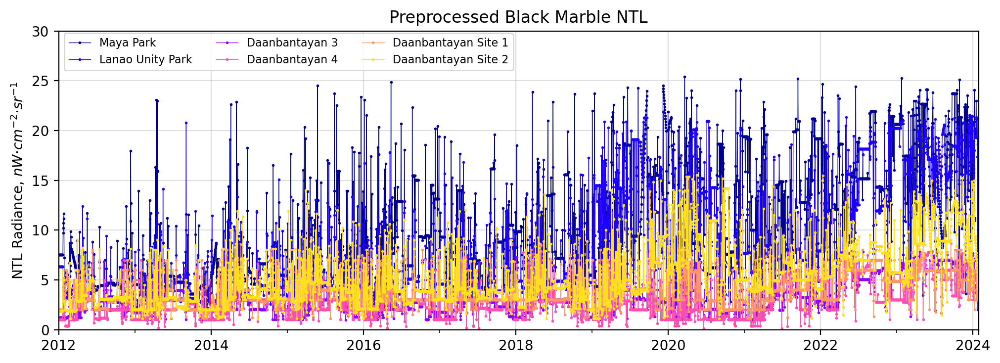

In [12]:
visualize_ts(NTL_test_processed)
plt.title("Preprocessed Black Marble NTL")

## moving average

Text(0.5, 1.0, 'Moving Average (365 days)')

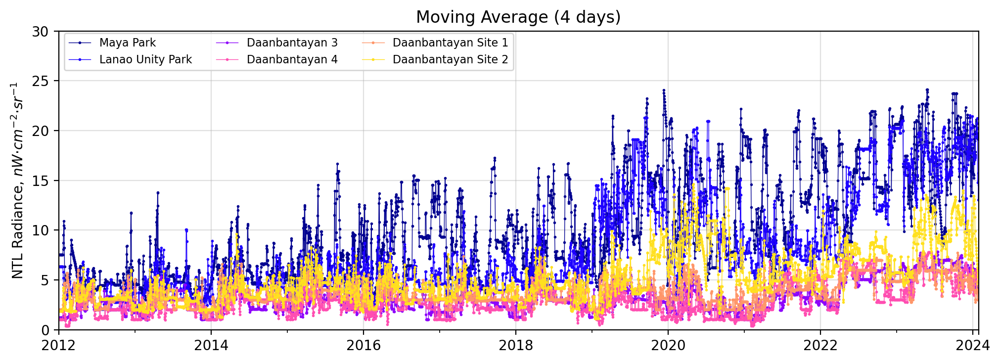

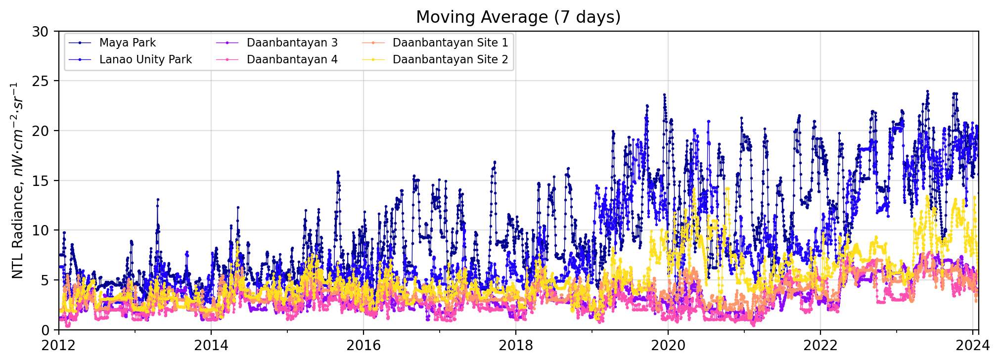

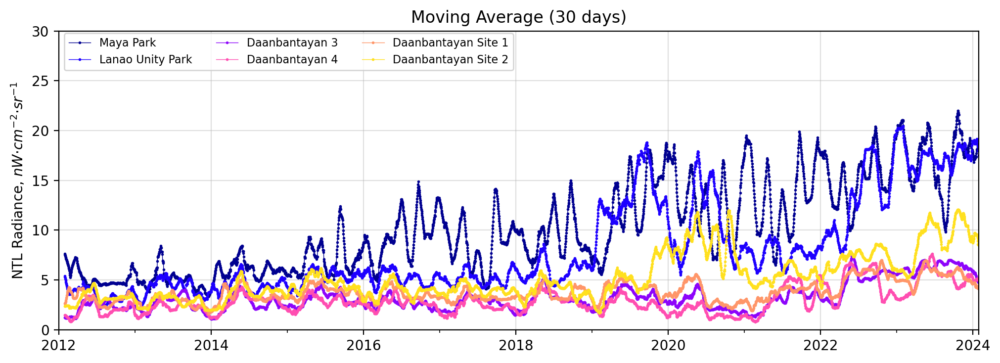

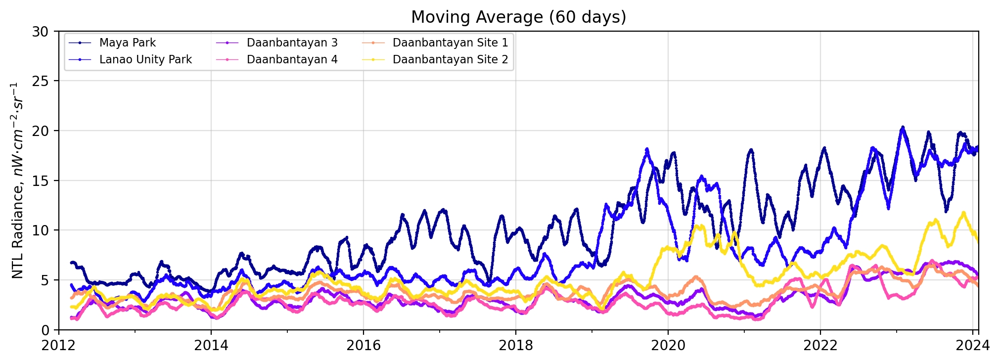

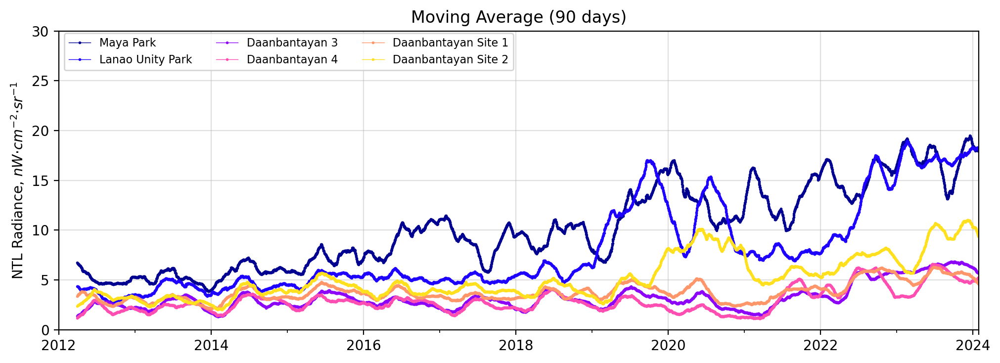

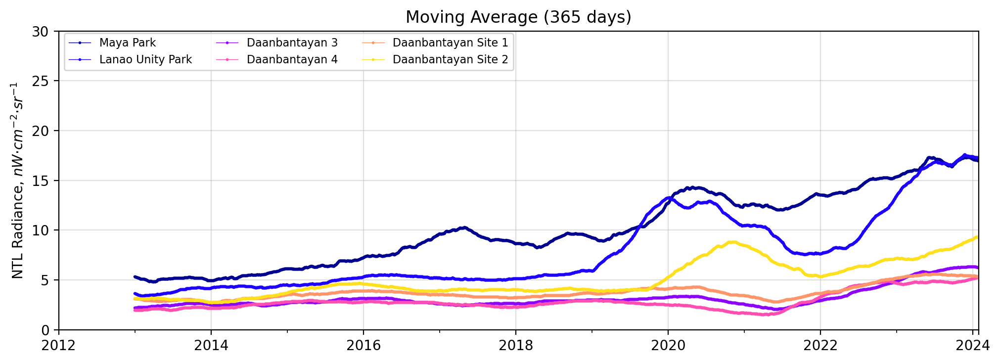

In [13]:

visualize_ts(NTL_test_processed.rolling(4).mean())
plt.title("Moving Average (4 days)")
visualize_ts(NTL_test_processed.rolling(7).mean())
plt.title("Moving Average (7 days)")
visualize_ts(NTL_test_processed.rolling(30).mean())
plt.title("Moving Average (30 days)")
visualize_ts(NTL_test_processed.rolling(60).mean())
plt.title("Moving Average (60 days)")
visualize_ts(NTL_test_processed.rolling(90).mean())
plt.title("Moving Average (90 days)")
visualize_ts(NTL_test_processed.rolling(365).mean())
plt.title("Moving Average (365 days)")

# Loading Resettlement Database

In [103]:
path = '/Users/reneprincipe/Library/CloudStorage/GoogleDrive-rlprincipe@up.edu.ph/My Drive/Research - PhD/Results/'

In [302]:
df = pd.read_excel(path + 'Philippine Resettlement Sites Database - RPrincipe et al. (2023).xlsx')

df['Latitude'] = pd.to_numeric(df['Latitude'], errors='coerce')
df['Longitude'] = pd.to_numeric(df['Longitude'], errors='coerce')
df['Buffer'] = pd.to_numeric(df['Buffer'], errors='coerce')
df = df[df['Buffer'].notna()].reset_index()
df_resettlement = df.copy()
# df_resettlement_ = df_resettlement
# df_resettlement['Title'].dropna()
df_resettlement

,index,Calamity,Project Name,Location,Classification,Latitude,Longitude,Buffer,Title,Map URL,Remarks,External Links,External Links.1,Typhoon,Province,Group
0,0,Typhoon Yolanda (2013),Maya Park Homes,"Brgy. Maya, Daanbantayan, Cebu",Identified,11.271009,124.048967,230.0,Maya Park,https://goo.gl/maps/3L3eRoigGDpjMxHT8,NaN,NaN,https://newsinfo.inquirer.net/944060/poor-nha-...,Yolanda,Cebu,Cebu
1,1,Typhoon Yolanda (2013),Lanao Unity Park Homes,"Brgy. Lanao, Daanbantayan, Cebu",Identified,11.248469,124.022224,280.0,Lanao Unity Park,https://goo.gl/maps/5SZCHBveYJqorcZ87,NaN,https://daanbantayan.gov.ph/2022/04/04/lanao-u...,NaN,Yolanda,Cebu,Cebu
2,2,Typhoon Yolanda (2013),Green Heights 1 (Daanbantayan 3),"Brgy. Tominjao, Daanbantayan, Cebu",Probable,11.221464,124.036788,260.0,Daanbantayan 3,https://goo.gl/maps/gjzeHfJ73dMTdiuX8,NaN,NaN,NaN,Yolanda,Cebu,Cebu
3,3,Typhoon Yolanda (2013),Green Heights 2 (Daanbantayan 4),"Brgy. Tominjao, Daanbantayan, Cebu",Identified,11.173075,124.015380,160.0,Daanbantayan 4,https://goo.gl/maps/1PfPDyVLY4bHvp78A,Adress was wrong on the NHA list. Turn-over da...,https://www.facebook.com/photo/?fbid=165837642...,NaN,Yolanda,Cebu,Cebu
4,4,Typhoon Yolanda (2013),Kandaya Homes 1 (Daanbantayan Site 1),"Brgy. Tapilon, Daanbantayan Site 1, Cebu",Identified,11.260164,124.036611,160.0,Daanbantayan Site 1,https://goo.gl/maps/2esB7Pmhx5NuNjYYA,Sites were raffled off to beneficiaries. Shape...,https://www.facebook.com/DaanbantayanLGU/photo...,https://www.facebook.com/DaanbantayanLGU/photo...,Yolanda,Cebu,Cebu
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
260,443,Typhoon Pepeng (2009),Tuba Resettlement Proj.,"Tuba, Benguet",Probable,14.604640,121.260761,450.0,Tuba Res,Google Maps Link,NaN,NaN,NaN,Pepeng,Benguet,Luzon
261,461,Typhoon Yolanda (2013),Brgy. Baldat (28 units),"Culion, Palawan",Probable,11.891470,119.987950,60.0,Badat,Apple Maps Link,NaN,NaN,NaN,Yolanda,Palawan,Luzon
262,462,Typhoon Yolanda (2013),Brgy. Binudac (406 units),"Culion, Palawan",Probable,11.820858,119.907452,100.0,Binudac,NaN,Probable Says it mentions 406 units but the un...,NaN,NaN,Yolanda,Palawan,Luzon
263,463,Typhoon Yolanda (2013),"Brgy. Galoc (274 units), Culion, Palawan","Culion, Palawan",Probable,11.922839,119.879509,250.0,Galoc,NaN,Still in the process; Buffer size also not sur...,NaN,NaN,Yolanda,Palawan,Luzon


In [303]:
# df_resettlement[df_resettlement['Province'] == 'Samar']

# Loading NTL dataframes

In [291]:
NTL_dataframe = pd.DataFrame(index = date_range)
for i, file in tqdm(enumerate(files)):
    NTL_data = pd.read_csv(data_path+file, index_col = 0, parse_dates=True)#.reset_index(drop=True)
    NTL_dataframe = pd.concat([NTL_dataframe, NTL_data*10], axis = 1)
    
NTL_dataframe = NTL_dataframe.loc[:, ~NTL_dataframe.columns.isna()]

NTL_dataframe



6it [00:00, 28.41it/s]


,Maya Park,Lanao Unity Park,Daanbantayan 3,Daanbantayan 4,Daanbantayan Site 1,Daanbantayan Site 2,Olivo Heights,Northview Park,Northview Park 2,Lawis Residences,...,Southville 9,Northville 2A,Dinalungan Heights,San Luis Villas,Dinalungan Res,Tuba Res,Badat,Binudac,Galoc,Balud
2012-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-01-24,18.637931,2.035714,2.208333,0.0,7.000000,0.000000,0.000000,0.000000,0.000000,8.719577,...,38.132132,139.622951,0.396947,2.0,0.396947,38.132132,3.769231,0.0,0.760976,1.0
2024-01-25,19.293103,21.130952,4.435185,6.0,3.000000,16.521739,4.296296,5.182857,2.956522,7.000000,...,40.548048,139.622951,1.000000,2.0,1.000000,40.548048,1.000000,1.0,1.921951,1.0
2024-01-26,19.293103,21.130952,4.435185,6.0,3.000000,16.521739,4.296296,5.182857,2.956522,7.000000,...,40.548048,180.573770,1.000000,2.0,1.000000,40.548048,1.000000,1.0,1.921951,1.0
2024-01-27,30.448276,7.952381,8.851852,11.0,11.168675,4.123188,4.296296,5.182857,4.217391,10.211640,...,40.548048,139.622951,1.000000,2.0,1.000000,40.548048,1.000000,1.0,1.921951,1.0


In [294]:
NTL_dataframe

,Maya Park,Lanao Unity Park,Daanbantayan 3,Daanbantayan 4,Daanbantayan Site 1,Daanbantayan Site 2,Olivo Heights,Northview Park,Northview Park 2,Lawis Residences,...,Southville 9,Northville 2A,Dinalungan Heights,San Luis Villas,Dinalungan Res,Tuba Res,Badat,Binudac,Galoc,Balud
2012-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2012-01-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-01-24,18.637931,2.035714,2.208333,0.0,7.000000,0.000000,0.000000,0.000000,0.000000,8.719577,...,38.132132,139.622951,0.396947,2.0,0.396947,38.132132,3.769231,0.0,0.760976,1.0
2024-01-25,19.293103,21.130952,4.435185,6.0,3.000000,16.521739,4.296296,5.182857,2.956522,7.000000,...,40.548048,139.622951,1.000000,2.0,1.000000,40.548048,1.000000,1.0,1.921951,1.0
2024-01-26,19.293103,21.130952,4.435185,6.0,3.000000,16.521739,4.296296,5.182857,2.956522,7.000000,...,40.548048,180.573770,1.000000,2.0,1.000000,40.548048,1.000000,1.0,1.921951,1.0
2024-01-27,30.448276,7.952381,8.851852,11.0,11.168675,4.123188,4.296296,5.182857,4.217391,10.211640,...,40.548048,139.622951,1.000000,2.0,1.000000,40.548048,1.000000,1.0,1.921951,1.0


## Preprocessing

In [295]:
def outlier_removal(dataframe):
    # Create an empty DataFrame to store the cleaned data
    cleaned_data = pd.DataFrame(index = date_range)

    # Iterate through each column
    for col in dataframe.columns:
        # Calculate column-specific quantiles
        q_low = dataframe[col].quantile(0.05)
        q_hi = dataframe[col].quantile(0.95)

        # Apply the condition to the column
        cleaned_col = dataframe[(dataframe[col] >= q_low) & (dataframe[col] <= q_hi)][col]

        # Add the cleaned column to the new DataFrame
        cleaned_data[col] = cleaned_col

    return cleaned_data

In [296]:
NTL_dataframe = outlier_removal(NTL_dataframe)
NTL_dataframe = NTL_dataframe.interpolate(method='linear', limit_direction='both')
NTL_dataframe

,Maya Park,Lanao Unity Park,Daanbantayan 3,Daanbantayan 4,Daanbantayan Site 1,Daanbantayan Site 2,Olivo Heights,Northview Park,Northview Park 2,Lawis Residences,...,Southville 9,Northville 2A,Dinalungan Heights,San Luis Villas,Dinalungan Res,Tuba Res,Badat,Binudac,Galoc,Balud
2012-01-01,7.505747,2.000000,1.226852,1.0,2.0,1.876812,2.000000,2.771429,1.652174,5.015873,...,10.849850,98.000000,0.603053,1.0,0.603053,10.849850,0.000000,0.4375,0.336585,0.173913
2012-01-02,7.505747,2.000000,1.226852,1.0,2.0,1.876812,2.000000,2.771429,1.652174,5.015873,...,10.849850,98.000000,0.603053,1.0,0.603053,10.849850,0.000000,0.4375,0.336585,0.173913
2012-01-03,7.505747,2.000000,1.226852,1.0,2.0,1.876812,2.000000,2.771429,1.652174,5.015873,...,10.849850,98.000000,0.603053,1.0,0.603053,10.849850,0.000000,0.4375,0.336585,0.173913
2012-01-04,7.505747,2.000000,1.226852,1.0,2.0,1.876812,2.000000,2.771429,1.652174,5.015873,...,10.849850,98.000000,0.603053,1.0,0.603053,10.849850,0.000000,0.4375,0.336585,0.173913
2012-01-05,7.505747,2.000000,1.226852,1.0,2.0,1.876812,2.000000,2.771429,1.652174,5.015873,...,10.849850,98.000000,0.603053,1.0,0.603053,10.849850,0.000000,0.4375,0.336585,0.173913
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-01-24,18.637931,2.035714,2.208333,0.0,7.0,5.109601,2.462963,5.182857,4.691304,7.000000,...,38.132132,139.622951,0.396947,2.0,0.396947,38.132132,3.769231,0.0000,0.760976,1.000000
2024-01-25,19.293103,21.130952,4.435185,6.0,3.0,4.780797,4.296296,5.182857,2.956522,7.000000,...,40.548048,139.622951,1.000000,2.0,1.000000,40.548048,1.000000,1.0000,1.921951,1.000000
2024-01-26,19.293103,21.130952,4.435185,6.0,3.0,4.451993,4.296296,5.182857,2.956522,7.000000,...,40.548048,180.573770,1.000000,2.0,1.000000,40.548048,1.000000,1.0000,1.921951,1.000000
2024-01-27,19.293103,7.952381,4.435185,6.0,3.0,4.123188,4.296296,5.182857,4.217391,7.000000,...,40.548048,139.622951,1.000000,2.0,1.000000,40.548048,1.000000,1.0000,1.921951,1.000000


## STL Decomposition

In [297]:
period = 365
trend = NTL_dataframe.copy()
seasonality = NTL_dataframe.copy()
residual = NTL_dataframe.copy()

for loc in tqdm(NTL_dataframe.columns, desc = 'STL Decomposition'):
    data = NTL_dataframe[loc].values
    decomposition = sm.tsa.seasonal_decompose(data, model='additive', period = period)
    trend[loc] = decomposition.trend
    seasonality[loc] = decomposition.seasonal
    residual[loc] = decomposition.resid

NTL_STL = pd.concat([NTL_dataframe,trend, seasonality, residual], axis = 1, keys = ['Raw', 'Trend', 'Seasonality', 'Residual'])
NTL_STL

STL Decomposition: 100%|█████████████████████| 267/267 [00:02<00:00, 130.82it/s]


Raw                                                 \
            Maya Park Lanao Unity Park Daanbantayan 3 Daanbantayan 4   
2012-01-01   7.505747         2.000000       1.226852            1.0   
2012-01-02   7.505747         2.000000       1.226852            1.0   
2012-01-03   7.505747         2.000000       1.226852            1.0   
2012-01-04   7.505747         2.000000       1.226852            1.0   
2012-01-05   7.505747         2.000000       1.226852            1.0   
...               ...              ...            ...            ...   
2024-01-24  18.637931         2.035714       2.208333            0.0   
2024-01-25  19.293103        21.130952       4.435185            6.0   
2024-01-26  19.293103        21.130952       4.435185            6.0   
2024-01-27  19.293103         7.952381       4.435185            6.0   
2024-01-28  19.293103         7.952381       4.435185            6.0   

                                                                  \
           Daanbantayan Site 1 Daanbantayan Site 2 Olivo Heights   
2012-01-01                 2.0            1.876812      2.000000   
2012-01-02                 2.0            1.876812      2.000000   
2012-01-03                 2.0            1.876812      2.000000   
2012-01-04                 2.0            1.876812      2.000000   
2012-01-05                 2.0            1.876812      2.000000   
...                        ...                 ...           ...   
2024-01-24                 7.0            5.109601      2.462963   
2024-01-25                 3.0            4.780797      4.296296   
2024-01-26                 3.0            4.451993      4.296296   
2024-01-27                 3.0            4.123188      4.296296   
2024-01-28                 3.0            4.123188      4.296296   

                                                              ...  \
           Northview Park Northview Park 2 Lawis Residences   ...   
2012-01-01       2.771429         1.652174          5.015873  ...   
2012-01-02       2.771429         1.652174          5.015873  ...   
2012-01-03       2.771429         1.652174          5.015873  ...   
2012-01-04       2.771429         1.652174          5.015873  ...   
2012-01-05       2.771429         1.652174          5.015873  ...   
...                   ...              ...               ...  ...   
2024-01-24       5.182857         4.691304          7.000000  ...   
2024-01-25       5.182857         2.956522          7.000000  ...   
2024-01-26       5.182857         2.956522          7.000000  ...   
2024-01-27       5.182857         4.217391          7.000000  ...   
2024-01-28       5.182857         4.217391          7.000000  ...   

               Residual                                                   \
           Southville 9 Northville 2A Dinalungan Heights San Luis Villas   
2012-01-01          NaN           NaN                NaN             NaN   
2012-01-02          NaN           NaN                NaN             NaN   
2012-01-03          NaN           NaN                NaN             NaN   
2012-01-04          NaN           NaN                NaN             NaN   
2012-01-05          NaN           NaN                NaN             NaN   
...                 ...           ...                ...             ...   
2024-01-24          NaN           NaN                NaN             NaN   
2024-01-25          NaN           NaN                NaN             NaN   
2024-01-26          NaN           NaN                NaN             NaN   
2024-01-27          NaN           NaN                NaN             NaN   
2024-01-28          NaN           NaN                NaN             NaN   

                                                              
           Dinalungan Res Tuba Res Badat Binudac Galoc Balud  
2012-01-01            NaN      NaN   NaN     NaN   NaN   NaN  
2012-01-02            NaN      NaN   NaN     NaN   NaN   NaN  
2012-01-03            NaN      NaN   NaN     NaN   NaN   

## Visualizing STL

In [154]:
def visualize_ts(dataframe):
    fig, ax = plt.subplots(dpi = 200, figsize = (12,4))
    fig.patch.set_facecolor('None')

    palette = sns.color_palette('Spectral', len(dataframe.columns))

    dataframe.plot(ax=ax, marker='o', markersize=0.2, linestyle='-', alpha = 0.5,
                     linewidth=0.2, color = palette, legend=False)
    ax.set_ylabel('NTL Radiance, $nW·cm^{−2}·sr^{−1}$')
    ax.grid(alpha = 0.4)

Text(0.5, 1.0, 'NTL Residual')

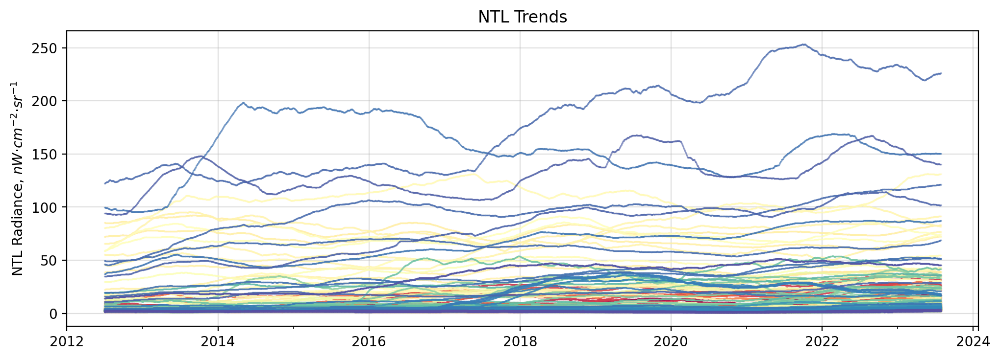

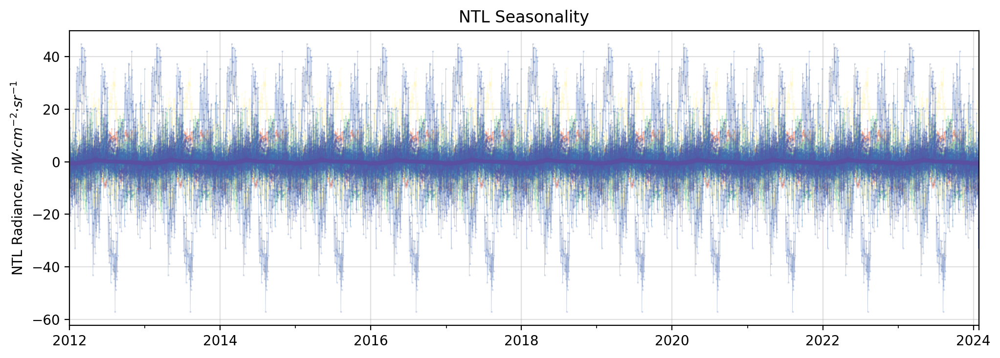

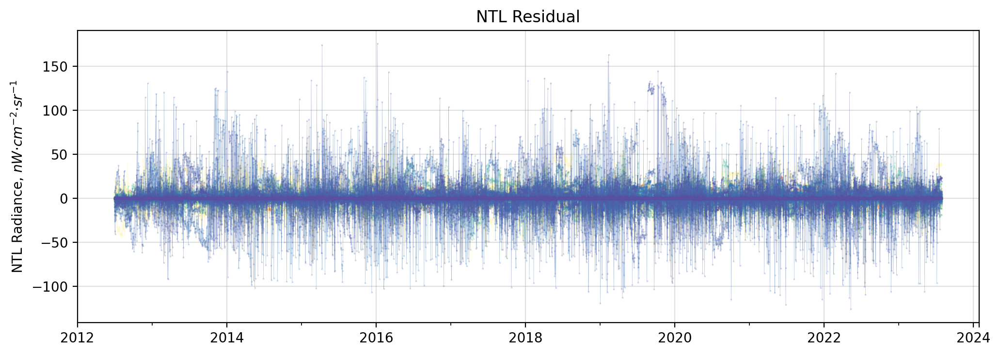

In [72]:
# visualize_ts(NTL_STL['Trend'])
# plt.title('NTL Trends')
# visualize_ts(NTL_STL['Seasonality'])
# plt.title('NTL Seasonality')
# visualize_ts(NTL_STL['Residual'])
# plt.title('NTL Residual')

In [155]:
# NTL_mov_ave = NTL_dataframe.rolling(365).mean()

# fig, ax = plt.subplots(dpi = 200, figsize = (12,4))
# fig.patch.set_facecolor('None')

# palette = sns.color_palette('Spectral', len(NTL_mov_ave.columns))

# NTL_mov_ave.plot(ax=ax, marker='o', markersize=0.2, linestyle='-', alpha = 0.5,
#                  linewidth=0.2, color = palette, legend=False)
# ax.set_ylabel('NTL Radiance, $nW·cm^{−2}·sr^{−1}$')
# ax.grid(alpha = 0.4)
# # plt.yscale('log')
# # plt.ylim(0,30)

In [156]:
# province = 'Samar'
# sites = df_resettlement.loc[df_resettlement['Province'] == province, 'Title'].unique()
# NTL_mov_ave[sites]

## Plotting Results

In [157]:
results_path = '/Users/reneprincipe/Library/CloudStorage/GoogleDrive-rlprincipe@up.edu.ph/My Drive/Research - PhD/Results/Plots/' 

### Provinces with >7 sites

In [136]:
province_counts = df_resettlement['Province'].value_counts()
select_provinces = province_counts[province_counts >= 7].index.tolist()
select_provinces

['Leyte',
 'Iloilo',
 'Antique',
 'Cebu',
 'Samar',
 'Misamis Oriental',
 'Negros Occidental',
 'Compostela',
 'Albay',
 'Aklan',
 'Biliran',
 'Davao Oriental',
 'Lanao Del Norte',
 'Capiz']

In [143]:
# for province in tqdm(select_provinces):
#     print('Province: ' + str(province))
#     sites = df_resettlement.loc[df_resettlement['Province'] == province, 'Title'].dropna().unique()

#     for i, site in enumerate(sites):
#         print('--- Processing ' + str(site))

  0%|                                                    | 0/14 [00:00<?, ?it/s]

Province: Leyte
--- Site: Kawayan Ville
--- Site: Villa Diana
--- Site: Ridge View Park
--- Site: New Hope Village
--- Site: Guadalupe Heights
--- Site: Knightsridge Residences
--- Site: VIlla Sofia
--- Site: North Hill Arbours
--- Site: Salvacion Heights
--- Site: St. Francis Village
--- Site: Kapuso Village Project Palo
--- Site: Ver Dominic Heights
--- Site: Prime Town Phase 1
--- Site: Prime Town Phase 3
--- Site: Channel Ridge View
--- Site: Pastrana Ville
--- Site: Carigara Housing Project
--- Site: Carigara Housing Project 1
--- Site: Ecoville
--- Site: Vergabriel's Heights
--- Site: Mayorga Towne Homes
--- Site: Paglaum Ville
--- Site: Mont Eagle Ville IV
--- Site: Tolosa Haiyan Village
--- Site: Matlang Heights
--- Site: Coconut Grove
--- Site: Bagong Pag-Asa
--- Site: Villa Soledad
--- Site: Virlyn Heights
--- Site: Tabango Ville
--- Site: Dulag Town Ville
--- Site: Barugo Town Ville 
--- Site: Villa Verde
--- Site: Capoocan Village
--- Site: Dagami Town Ville
--- Site: Sta. 

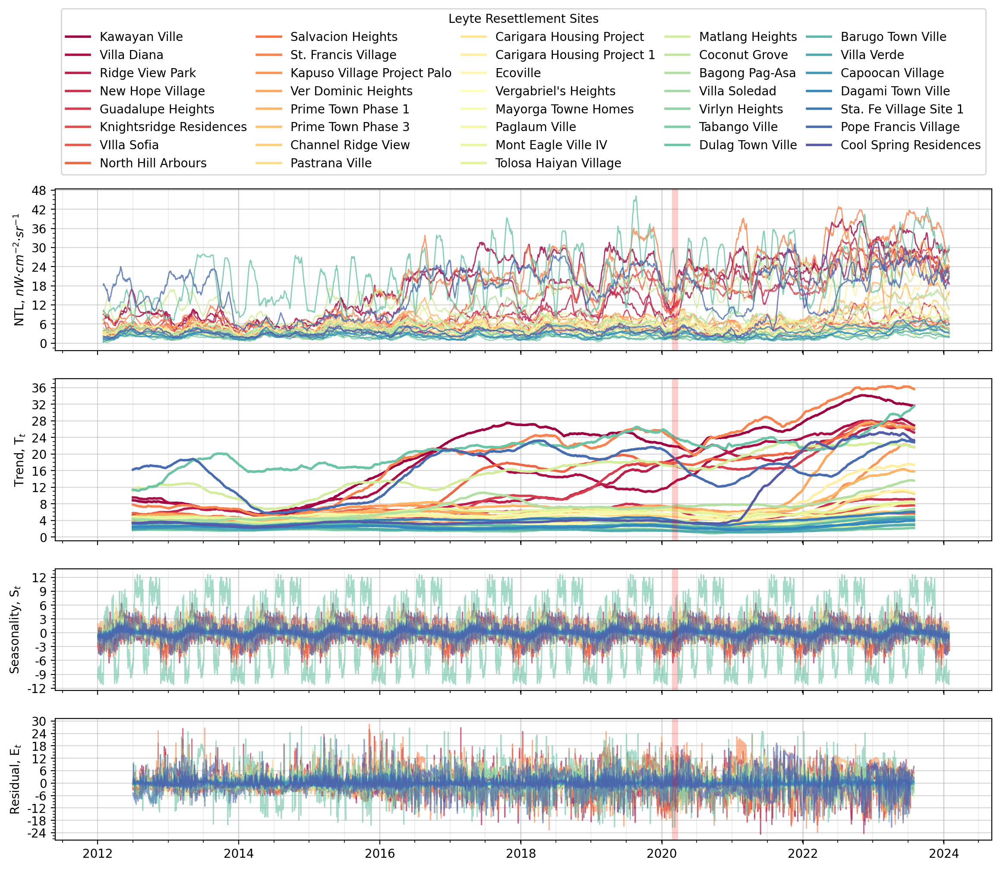

  7%|███▏                                        | 1/14 [00:09<02:02,  9.39s/it]

Province: Iloilo
--- Site: Anilao
--- Site: Ajuy
--- Site: Pili Site 1/2
--- Site: Tipacla Site 1
--- Site: Tipacla Site 2
--- Site: Adcadarao
--- Site: Malayuan 
--- Site: Malayuan 2
--- Site: Banate 
--- Site: Viejo Site
--- Site: Hamod
--- Site: St. Therese Village
--- Site: St. Vincent
--- Site: Nalumsan 
--- Site: Abong
--- Site: Bolo 
--- Site: Barosbos 
--- Site: Guincticgan
--- Site: Concepcion Site 1
--- Site: Bacjawan Sur
--- Site: Concepcion Site 2
--- Site: Estancia
--- Site: Villa Regeneracion
--- Site: Estancia Site 1
--- Site: Estancia Site 2
--- Site: Bulaquena
--- Site: Gogo Site
--- Site: Granville
--- Site: Barotac Nuevo


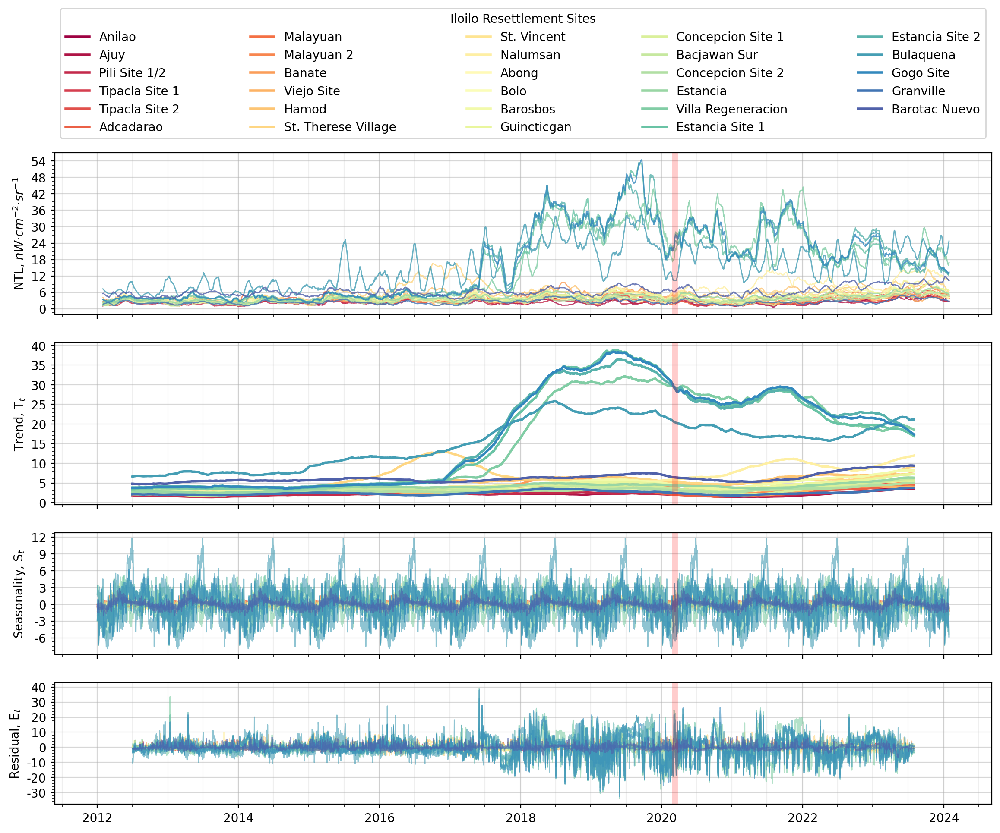

 14%|██████▎                                     | 2/14 [00:18<01:49,  9.10s/it]

Province: Antique
--- Site: Capoyuan Homes 2
--- Site: Barbaza Residences 1
--- Site: Barbaza Residences 2
--- Site: Atabay Homes
--- Site: Bugasong Res
--- Site: Bugasong New Paradise
--- Site: Igbalangao Homes
--- Site: Esperanza Homes
--- Site: Laua-an Res.
--- Site: Villa Guinbanga-an
--- Site: Villa Igtadiao 1
--- Site: Villa Igtadiao 2 
--- Site: Villa Lugta
--- Site: Villa Lindero
--- Site: Villa Lupa-an 1
--- Site: Villa Lupa-an 2
--- Site: Villa Lindero 2
--- Site: Sta. Cruz Site 1
--- Site: Guia Homes
--- Site: Tingib Homes
--- Site: Sta. Cruz
--- Site: Poblacion Village
--- Site: San Rafael
--- Site: Sebaste
--- Site: GBB
--- Site: San Francisco Norte


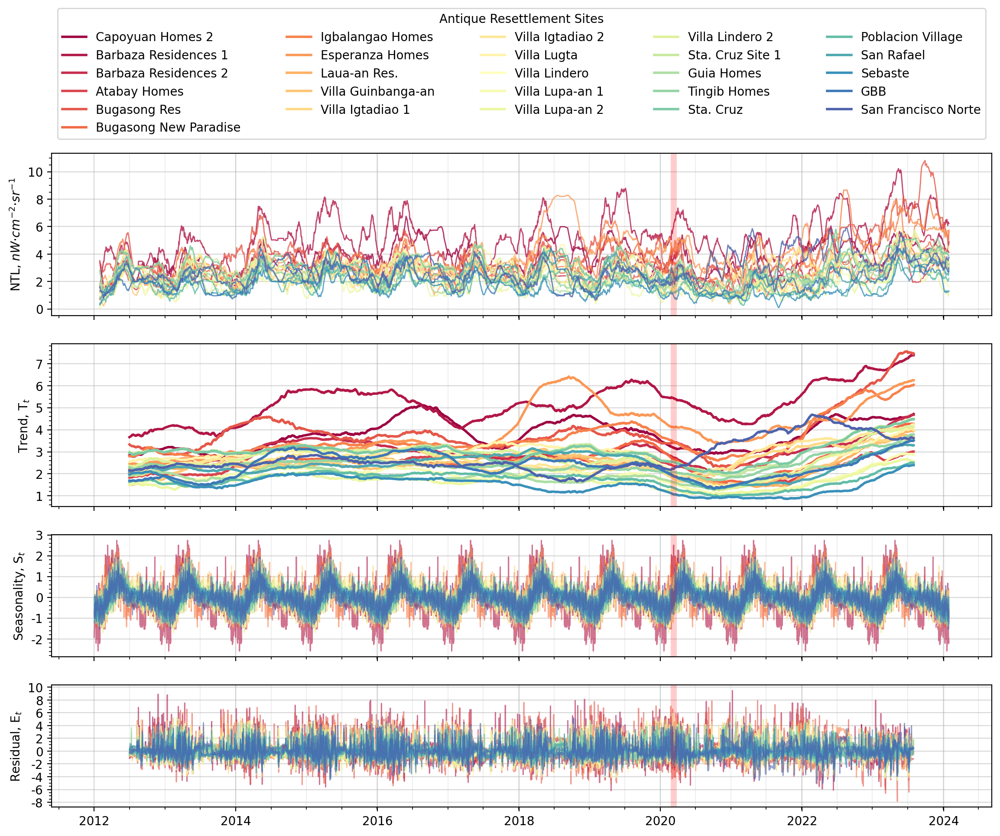

 21%|█████████▍                                  | 3/14 [00:26<01:34,  8.55s/it]

Province: Cebu
--- Site: Maya Park
--- Site: Lanao Unity Park
--- Site: Daanbantayan 3
--- Site: Daanbantayan 4
--- Site: Daanbantayan Site 1
--- Site: Daanbantayan Site 2
--- Site: Olivo Heights
--- Site: Northview Park
--- Site: Northview Park 2
--- Site: Lawis Residences 
--- Site: San Remigio Heights
--- Site: Bogo Housing Project
--- Site: Seawood Residences
--- Site: Borbon Housing Project
--- Site: Sogod Housing Project
--- Site: Lantawan Homes 
--- Site: Sto. Niño Homes
--- Site: Balai Bantayan
--- Site: Kabyayan ni Orongel
--- Site: Kabyayan ni Datu Leon
--- Site: St. Francis Park Homes 2
--- Site: Poro
--- Site: Tudela Housing


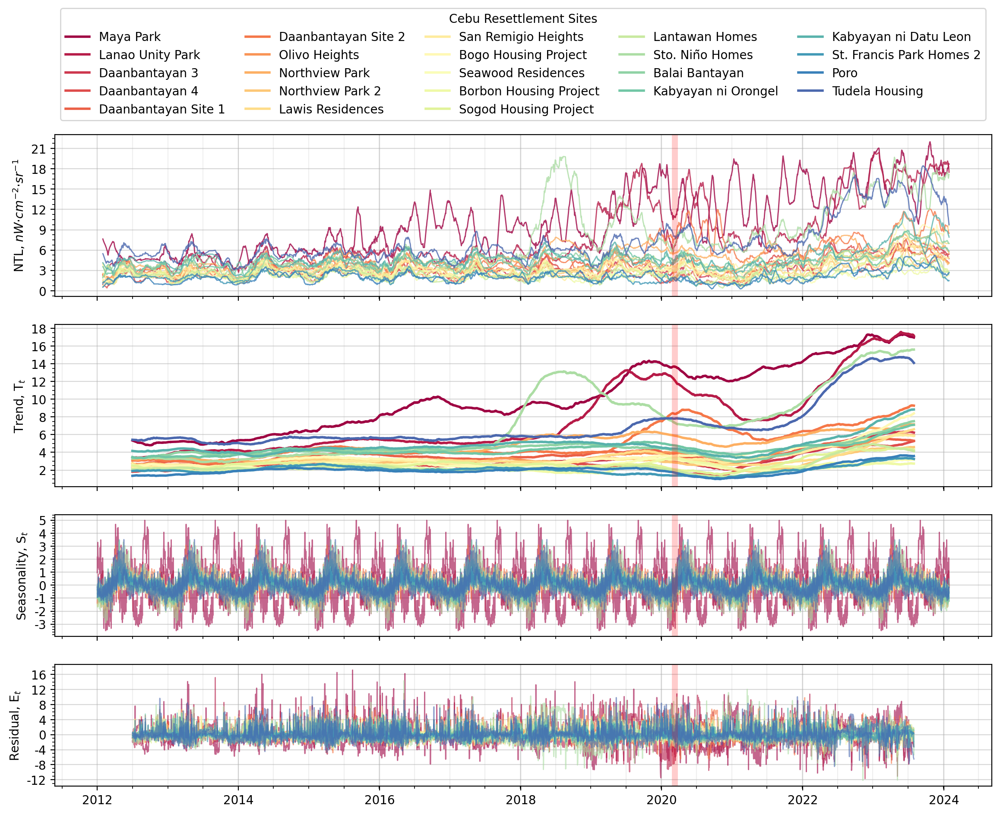

 29%|████████████▌                               | 4/14 [00:33<01:19,  7.96s/it]

Province: Samar
--- Site: St. Genevieve Village
--- Site: St. Genevieve Site 1/ 2
--- Site: Eastwind Residences
--- Site: Samar Forestdale I
--- Site: Balangiga Town Ville
--- Site: Hernani Town Ville
--- Site: Quinapondan Town Ville
--- Site: Gen. MacArthur Townville
--- Site: Mont Peak Estate
--- Site: Salcedo Housing Project
--- Site: Rondale Residences
--- Site: Giporlos Greenfields
--- Site: San Lorenzo Residences
--- Site: Basey Point/Point 2A
--- Site: Basey Point 1/ 5
--- Site: Green Park 1 
--- Site: Green Park 2 
--- Site: Marabut Ville Site 1 
--- Site: Sta. Rita Greenfields


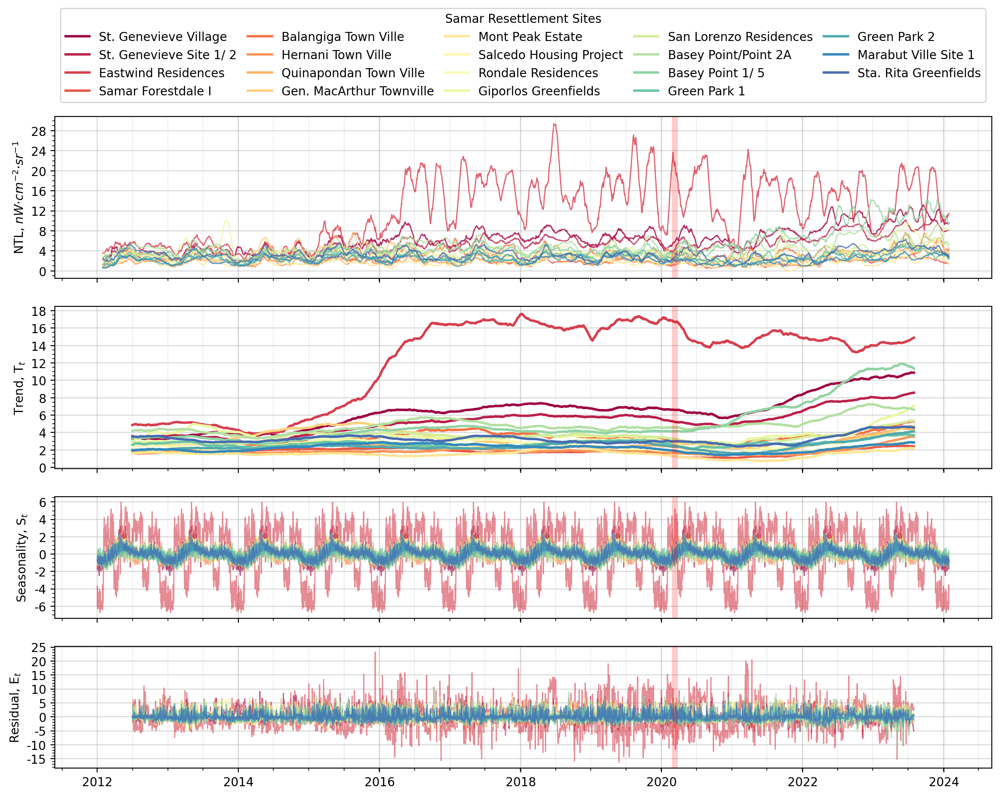

 36%|███████████████▋                            | 5/14 [00:39<01:05,  7.24s/it]

Province: Misamis Oriental
--- Site: NHA-CDO VIII 1
--- Site: NHA-CDO Bayanihan 2
--- Site: NHA-Lumbia Heights
--- Site: NHA-Mambuaya 1
--- Site: CDO RSHP Phase 2
--- Site: CDO RSHP Phase 3
--- Site: Indahag Rel Site
--- Site: Indahag Rel Site Ph. 2
--- Site: GK VILLAGE
--- Site: Calaanan Mahogany
--- Site: Canitoan Rel Site
--- Site: Caritas Village
--- Site: Tabang Cagayan Ph. 1
--- Site: Xavier Eco Village
--- Site: Pagatpat Rel Site
--- Site: Divine Mercy Village


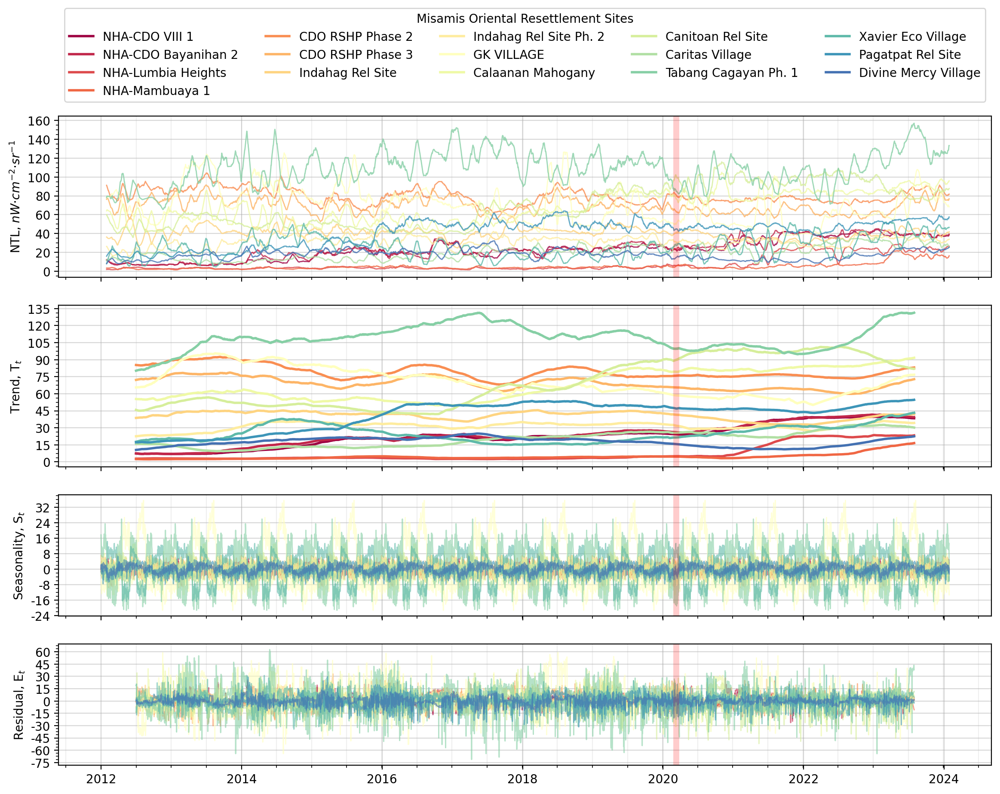

 43%|██████████████████▊                         | 6/14 [00:44<00:53,  6.72s/it]

Province: Negros Occidental
--- Site: St. Patrick Homes 1
--- Site: Don Salvador Heights 1
--- Site: Don Salvador Heights 2
--- Site: Apollo Village
--- Site: Len-Vil Homes
--- Site: Lacson Villas
--- Site: St. Andrew
--- Site: Escalate Heights 1
--- Site: Chambery Homes 1
--- Site: St. James Ville
--- Site: Dona Josefina Ville
--- Site: Lizares Village
--- Site: Paraiso Heights 2
--- Site: Paraiso Heights 1
--- Site: Ledesma Res


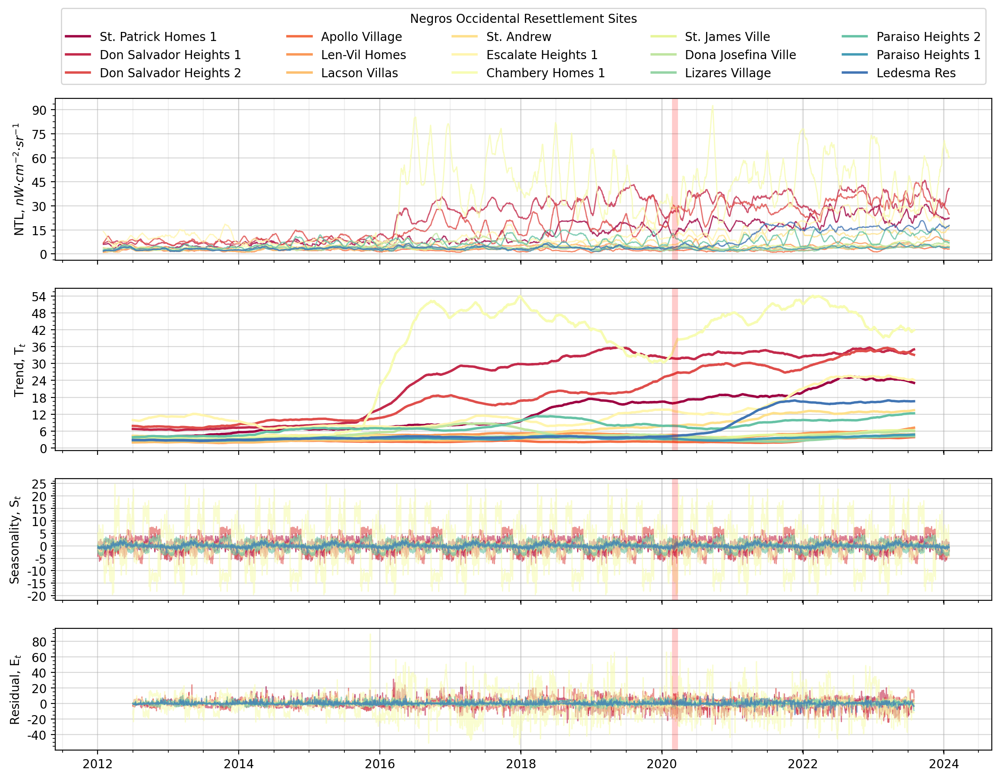

 50%|██████████████████████                      | 7/14 [00:49<00:43,  6.18s/it]

Province: Compostela
--- Site: San Antonio Village 2
--- Site: Monkayo Hsg. Proj. 1
--- Site: Monkayo Hsg. Proj. 2
--- Site: Monkayo Hsg. Proj. 3
--- Site: Monkayo Hsg. Proj. 3A
--- Site: Monkayo Hsg. Proj. 4
--- Site: Monkayo Hsg. Proj. 5
--- Site: Olive Heights Ville
--- Site: Lower Ulip Res
--- Site: Sariwarain Village
--- Site: Sarimagdaleno Village
--- Site: RJ Village
--- Site: Mont Eagle Ville Subdv.
--- Site: Vida Vista Subdivision
--- Site: New Bataan Res


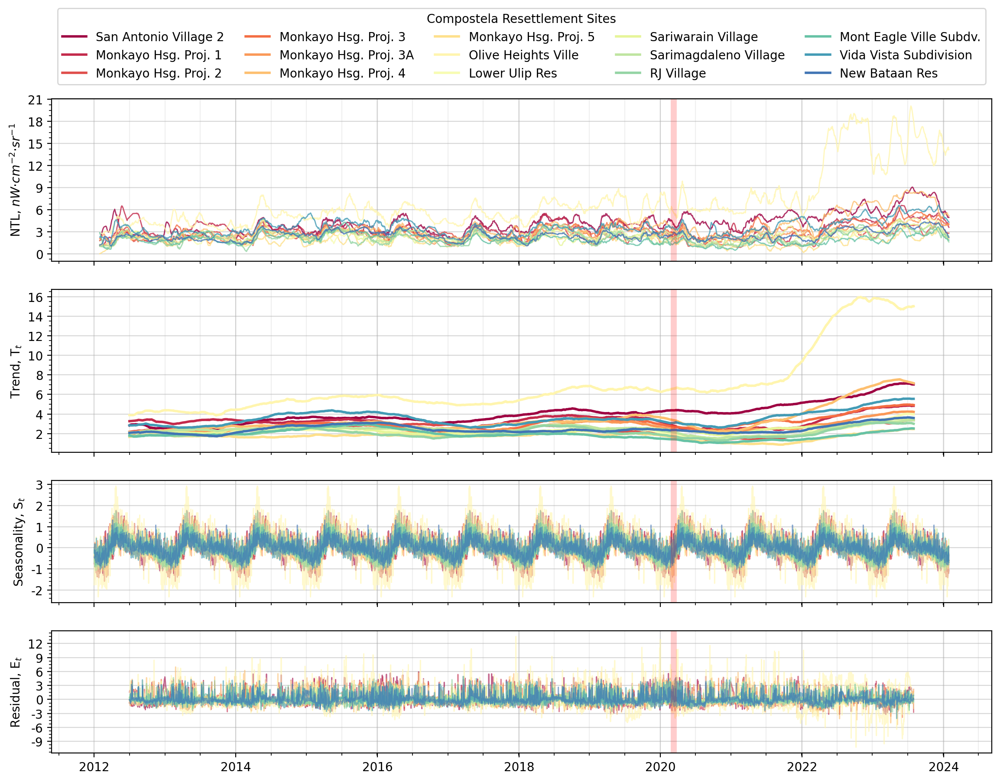

 57%|█████████████████████████▏                  | 8/14 [00:55<00:35,  5.90s/it]

Province: Albay
--- Site: Tabaco Housing
--- Site: Balai Tiwi
--- Site: Anislag Res Project 1&2
--- Site: Anislag Res 3
--- Site: Banquerohan Res
--- Site: Taysan Res
--- Site: Camalig Res
--- Site: Sto. Domingo Res
--- Site: Ligao Res 
--- Site: Polangui Res
--- Site: Quitago Res
--- Site: Mauraro Res
--- Site: Bascaran Res
--- Site: Baligang Res


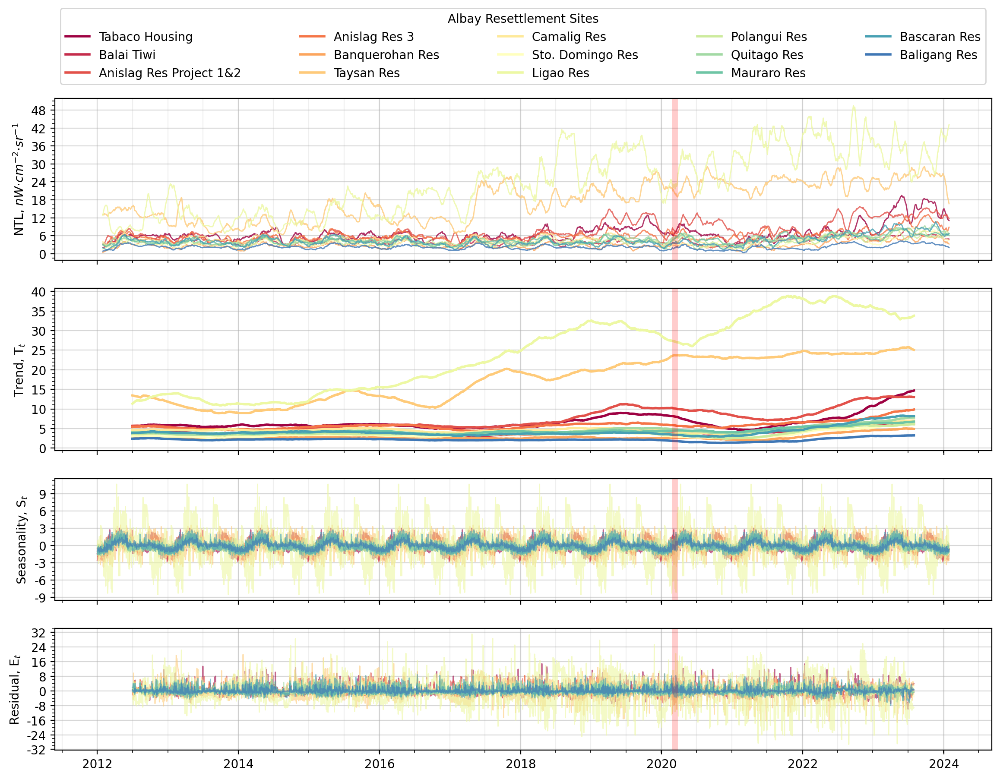

 64%|████████████████████████████▎               | 9/14 [01:00<00:28,  5.65s/it]

Province: Aklan
--- Site: Altavas Site 1/2
--- Site: Batan Permanent
--- Site: Briones Homes
--- Site: New Washington
--- Site: Cardinal Ville
--- Site: Olympus 1
--- Site: Shimonette Homes
--- Site: Olympus 5
--- Site: Tangalan
--- Site: Bagongbayan
--- Site: Malay NHA Yolanda
--- Site: Numancia Housing


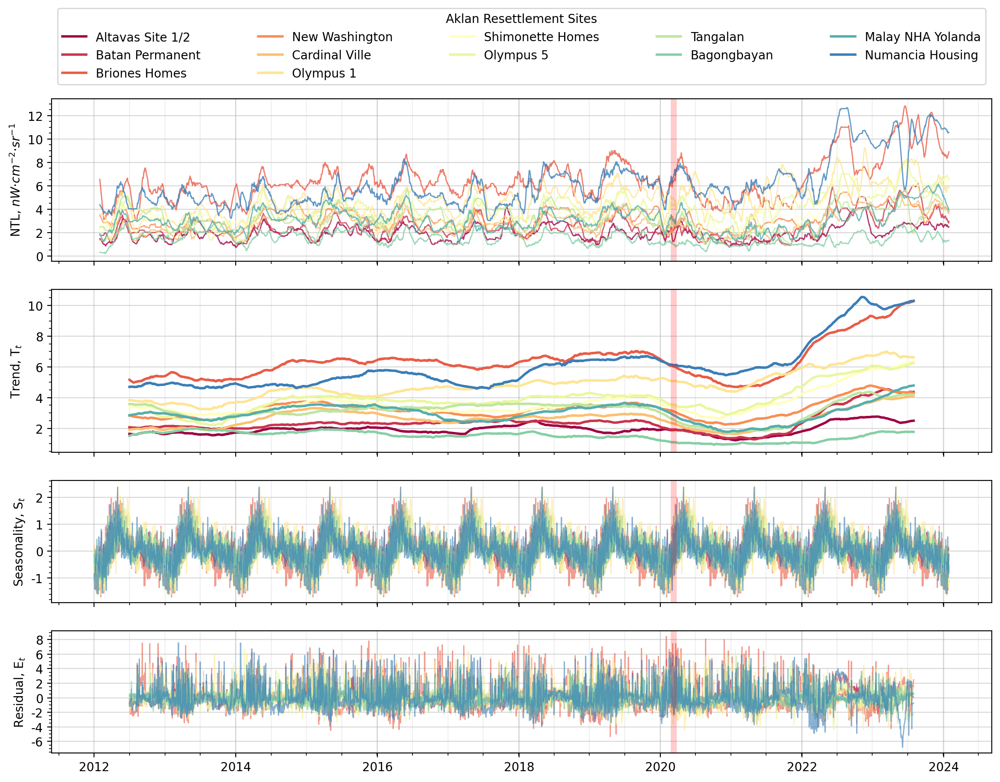

 71%|██████████████████████████████▋            | 10/14 [01:05<00:21,  5.42s/it]

Province: Biliran
--- Site: Vista del Mar 3
--- Site: Junction Ville
--- Site: Cool Mont Crest
--- Site: Divine Grace Village
--- Site: San Antonio Village
--- Site: Biliran Lucky Residences 
--- Site: Vermatthew Heights
--- Site: Almeria Housing
--- Site: San Lorenzo Heights
--- Site: Mont Peak East
--- Site: Mont Peak East 2


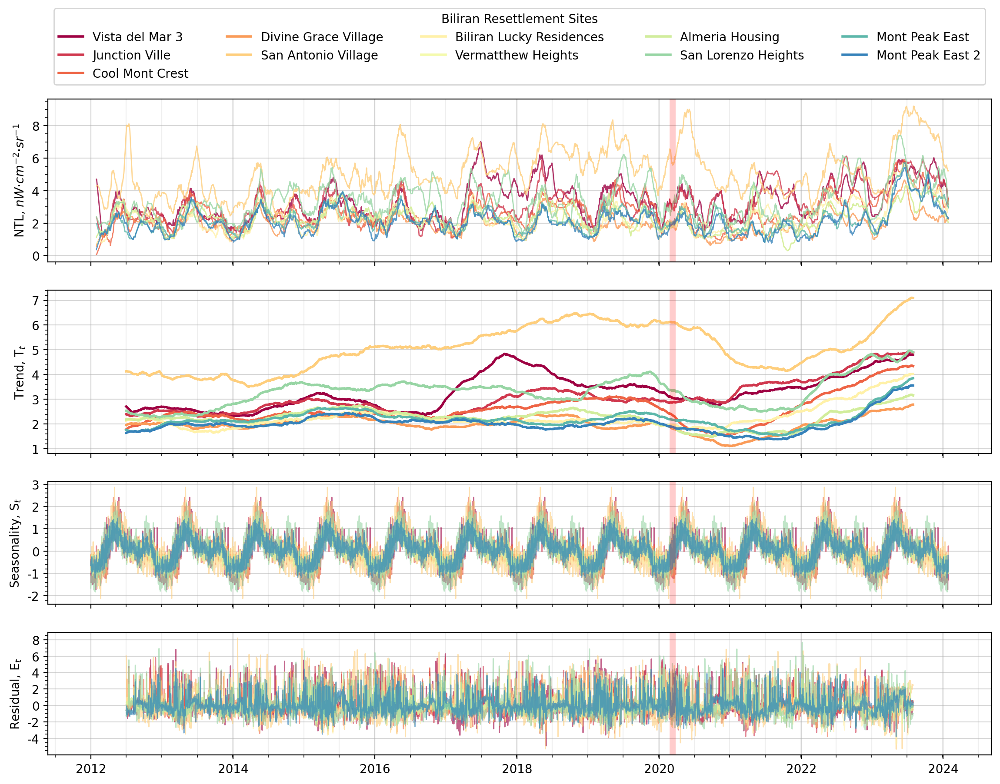

 79%|█████████████████████████████████▊         | 11/14 [01:10<00:15,  5.24s/it]

Province: Davao Oriental
--- Site: San Alfonso
--- Site: San Antonio III
--- Site: Cateel
--- Site: Baculin
--- Site: Kinablangan
--- Site: Caraga
--- Site: Boston Res
--- Site: MVP Homes


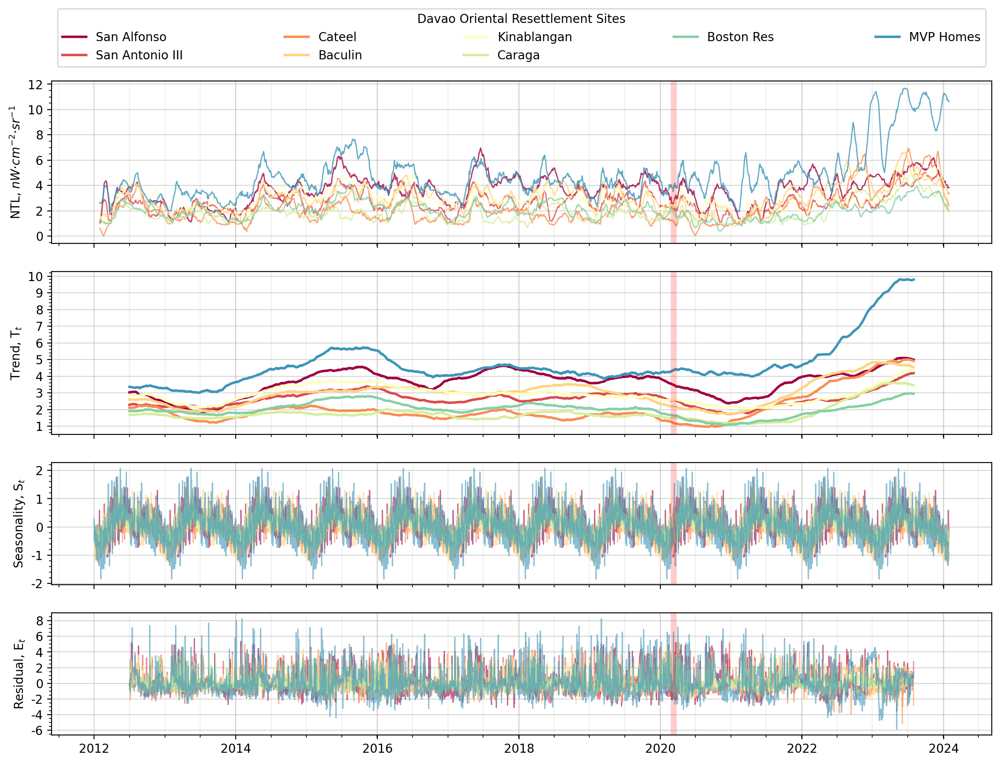

 86%|████████████████████████████████████▊      | 12/14 [01:14<00:09,  4.95s/it]

Province: Lanao Del Norte
--- Site: Highland Residences
--- Site: Iligan Bay Vista Village
--- Site: Kapuso Village 1
--- Site: Diocese of Iligan Village
--- Site: Red Cross Village
--- Site: Bayanihan Village
--- Site: Kapuso Village 2


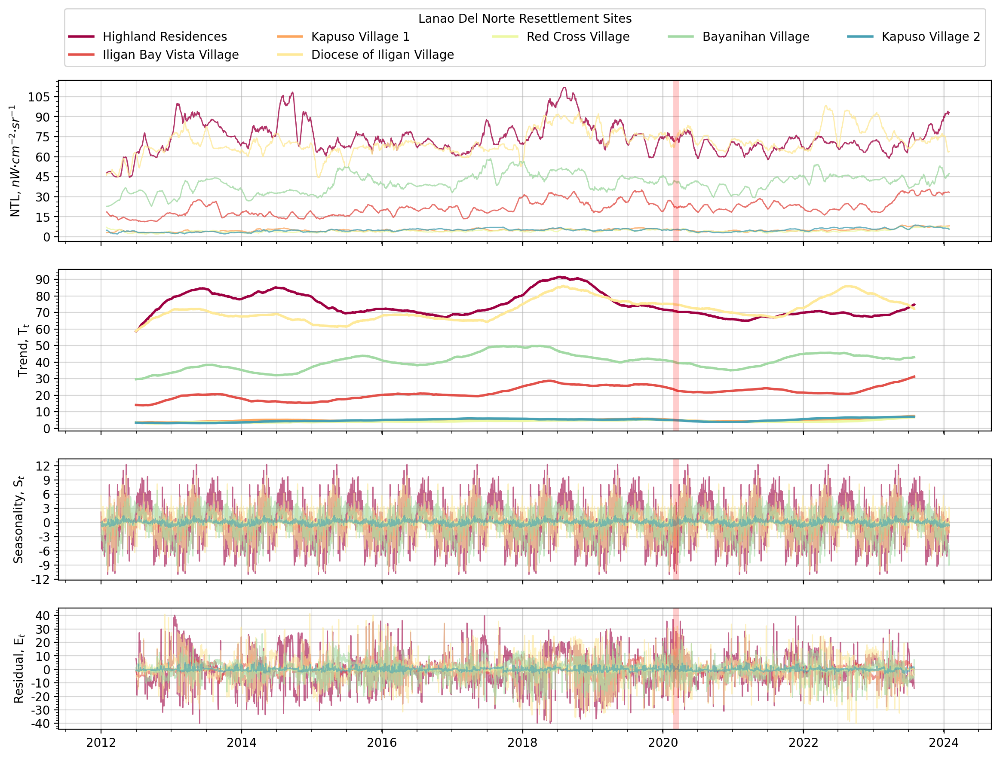

 93%|███████████████████████████████████████▉   | 13/14 [01:18<00:04,  4.68s/it]

Province: Capiz
--- Site: Villa Medalla Milagrosa
--- Site: Pontevedra Ville
--- Site: Vizcaya Ville
--- Site: Jumaguicguic Ville Hsg. Proj.
--- Site: Tanza Ville Subdivision
--- Site: Sapi-an Ville Hsg. Proj.
--- Site: Ivisan Ville


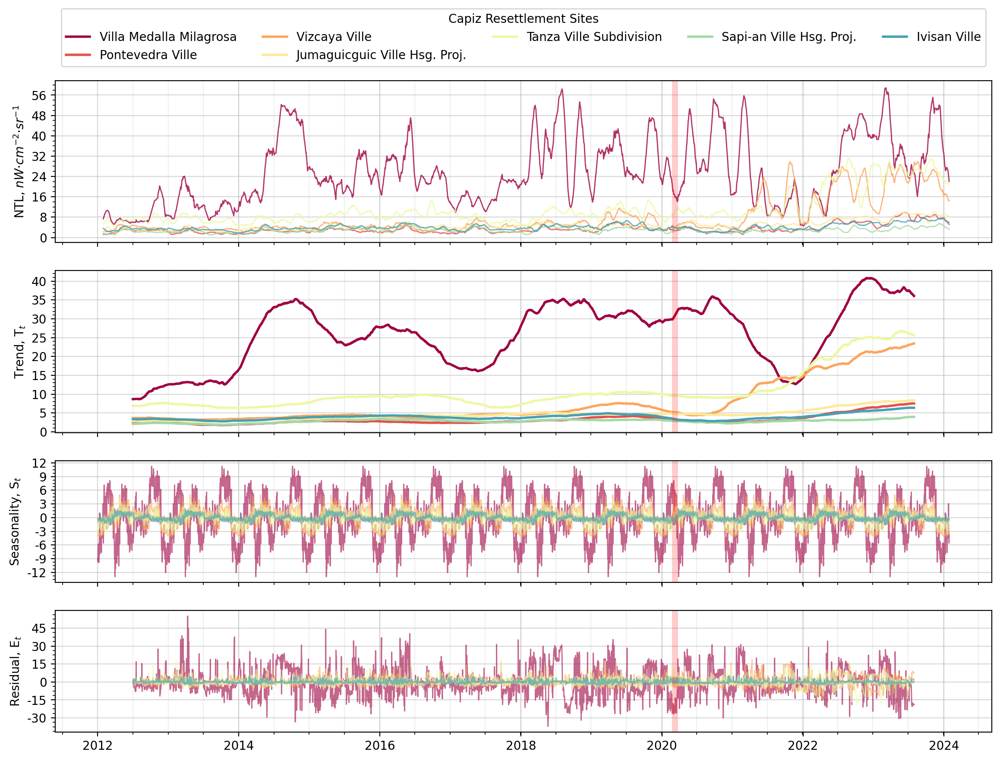

100%|███████████████████████████████████████████| 14/14 [01:22<00:00,  5.88s/it]


In [151]:
# provinces = df_resettlement['Province'].unique()

for province in tqdm(select_provinces):
    print('Province: ' + str(province))
    sites = df_resettlement.loc[df_resettlement['Province'] == province, 'Title'].dropna().unique()
    fig, ax = plt.subplots(nrows=4,ncols=1, sharex='col',
                      gridspec_kw={'height_ratios':[2,2,1.5,1.5]},
                      figsize=(14,10), dpi = 200)
    
    for i, site in enumerate(sites):
        print('--- Site: ' + str(site))
        data = NTL_STL['Raw'][site].rolling(30).mean()
        line_color = plt.cm.Spectral(i/len(sites))
        ax[0].plot(date_range, data, color = line_color, linewidth = 1, alpha = 0.8)
        ax[0].set_ylabel('NTL, $nW ·cm^{−2}·sr^{−1}$')

        ax[1].plot(date_range, NTL_STL['Trend'][site], color = line_color,
                alpha = 1, label= sites[i], lw = 2)
        ax[1].set_ylabel('Trend, T$_t$')

        ax[2].plot(date_range, NTL_STL['Seasonality'][site], color = line_color,
                linewidth = 1, alpha = 0.6)
        ax[2].set_ylabel('Seasonality, S$_t$')

        ax[3].plot(date_range, NTL_STL['Residual'][site], color = line_color,
            linewidth = 1, alpha = 0.6)
        ax[3].set_ylabel('Residual, E$_t$')

    ax[1].legend(fontsize=10, ncol = 5, bbox_to_anchor= (0, 1.05, 1, 0.5), loc="lower left",
                bbox_transform=ax[0].transAxes, fancybox = True, mode='expand', 
                title = str(province) + ' Resettlement Sites')

    for ax in ax:
        ax.grid(alpha = 0.5)
        ax.axvline(datetime.date(2020, 3, 10), color = 'r', lw = 5, alpha = 0.2) #For COVID lockdown
        ax.yaxis.set_major_formatter(mtick.FormatStrFormatter('%.0f')) # 0 decimal places)
        ax.minorticks_on()
        ax.xaxis.grid(True, which='minor', alpha = 0.2) 
        ax.yaxis.set_major_locator(MaxNLocator(integer=True))

    dtFmt = mdates.DateFormatter('%Y') # define the formatting
    plt.gca().xaxis.set_major_formatter(dtFmt) # apply the format to the desired axis
    plt.tight_layout()
    plt.savefig(results_path+str(province)+".png", bbox_inches="tight")
    plt.show()

# Extracting Trend Statistics

In [310]:
NTL_Trend = NTL_STL['Trend'].dropna()

stats_summary = pd.DataFrame(index = df_resettlement['Title'],
                            columns = ['slope', 'intercept', 'r', 'p', 'std'])

stats_summary

,slope,intercept,r,p,std
Title,,,,,
Maya Park,NaN,NaN,NaN,NaN,NaN
Lanao Unity Park,NaN,NaN,NaN,NaN,NaN
Daanbantayan 3,NaN,NaN,NaN,NaN,NaN
Daanbantayan 4,NaN,NaN,NaN,NaN,NaN
Daanbantayan Site 1,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
Tuba Res,NaN,NaN,NaN,NaN,NaN
Badat,NaN,NaN,NaN,NaN,NaN
Binudac,NaN,NaN,NaN,NaN,NaN


In [317]:
from scipy.stats import linregress


for i, site in tqdm(enumerate(df_resettlement['Title'])):
    y = NTL_Trend[site]
    x = np.arange(len(y))
    slope, intercept, r_value, p_value, std_err = linregress(x,y)
    stats_summary.loc[site] = np.asarray(linregress(x,y))
    
# stats_summary['Province'] = df_resettlement['Province']
stats_summary

165it [00:00, 1949.82it/s]


KeyError: nan

In [301]:
df_resettlement['Province']

0         Cebu
1         Cebu
2         Cebu
3         Cebu
4         Cebu
        ...   
260    Benguet
261    Palawan
262    Palawan
263    Palawan
264    Palawan
Name: Province, Length: 265, dtype: object

In [286]:
# df_resettlement['Province']

stats_summary.index

Index(['Maya Park', 'Lanao Unity Park', 'Daanbantayan 3', 'Daanbantayan 4',
       'Daanbantayan Site 1', 'Daanbantayan Site 2', 'Olivo Heights',
       'Northview Park', 'Northview Park 2', 'Lawis Residences ',
       ...
       'Southville 9', 'Northville 2A', 'Dinalungan Heights',
       'San Luis Villas', 'Dinalungan Res', 'Tuba Res', 'Badat', 'Binudac',
       'Galoc', 'Balud'],
      dtype='object', length=267)

In [274]:
stats_summary.index

Index(['Maya Park', 'Lanao Unity Park', 'Daanbantayan 3', 'Daanbantayan 4',
       'Daanbantayan Site 1', 'Daanbantayan Site 2', 'Olivo Heights',
       'Northview Park', 'Northview Park 2', 'Lawis Residences ',
       ...
       'Southville 9', 'Northville 2A', 'Dinalungan Heights',
       'San Luis Villas', 'Dinalungan Res', 'Tuba Res', 'Badat', 'Binudac',
       'Galoc', 'Balud'],
      dtype='object', length=267)

In [276]:
# Assuming you have 'Title' column in df_resettlement and 'stats_summary' DataFrame

# Find the difference between 'Title' column and stats_summary index
title_difference = set(df_resettlement['Title']).difference(stats_summary.index)

# Display the result
print("Titles in df_resettlement but not in stats_summary:")
print(title_difference)


Titles in df_resettlement but not in stats_summary:
{nan}


In [267]:
plt.figure(figsize=(6,4), dpi = 150)
plt.grid()
sns.regplot(stats_summary['slope'], stats_summary['intercept'], 'o')
plt.yscale('log')
# plt.xscale('log')
plt.xlabel('slope')
plt.ylabel('intercept')

Text(0, 0.5, 'intercept')

ValueError: Data has no positive values, and therefore can not be log-scaled.

ValueError: Supply a 'c' argument or a 'color' kwarg but not both; they differ but their functionalities overlap.

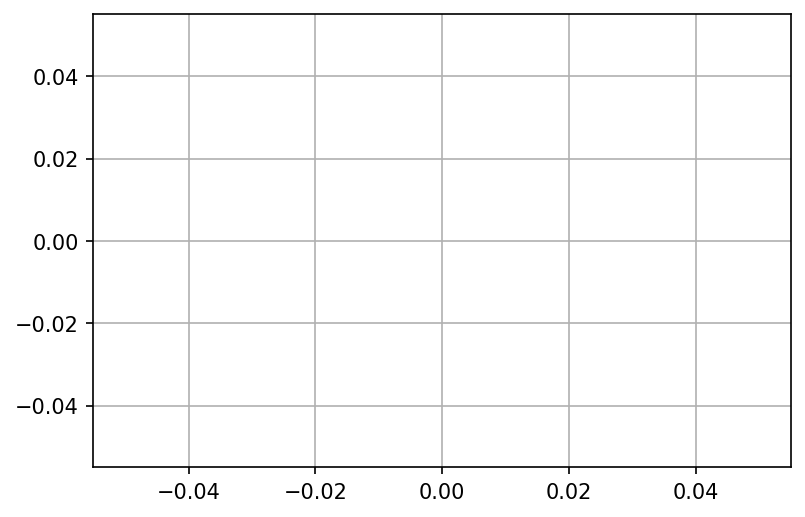

In [252]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming you have your data loaded in a DataFrame named 'stats_summary'
# stats_summary should have 'slope', 'intercept', and optionally 'color_variable' columns

# Example data (replace with your actual data)
slope_values = stats_summary['slope']
intercept_values = stats_summary['intercept']
# color_variable = stats_summary['color_variable']  # Replace with your actual color variable or remove if not applicable

# Set up the figure and grid
plt.figure(figsize=(6, 4), dpi=150)
plt.grid()

# Create a scatter plot with a regression line and colormap
sns.regplot(x=slope_values, y=intercept_values, scatter_kws={'s': 50, 'c': 'red', 'cmap': 'viridis'}, line_kws={'color': 'black'})

plt.yscale('log')
# plt.xscale('log')
plt.xlabel('Slope')
plt.ylabel('Intercept')

# # Show colorbar for reference
# if 'color_variable' in stats_summary.columns:
#     plt.colorbar(label='Color Variable')

plt.show()


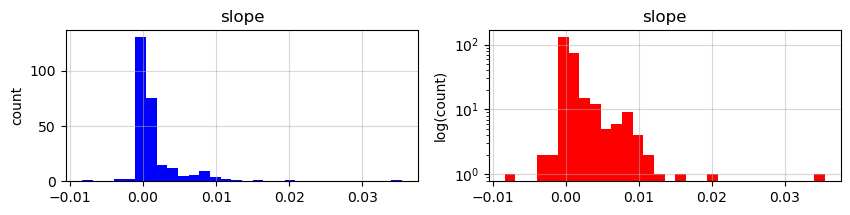

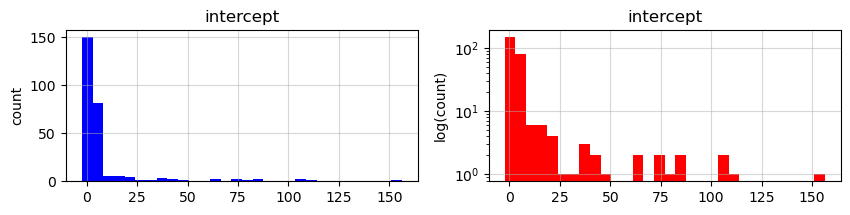

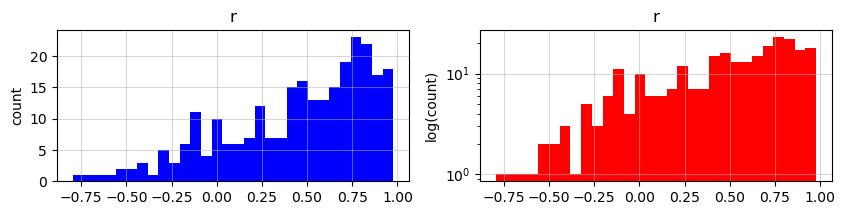

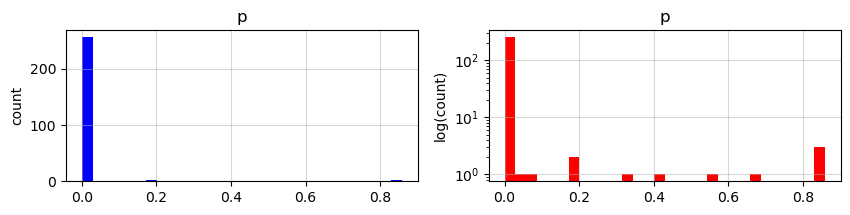

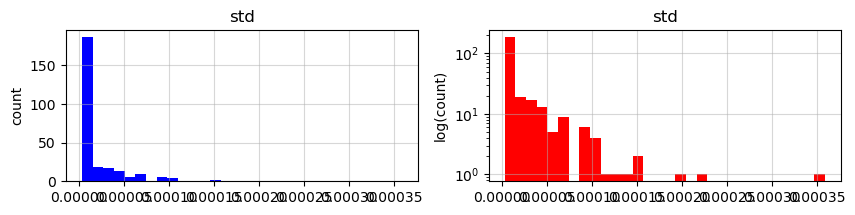

In [231]:
for stats in stats_summary.columns:
    plt.figure(figsize=(10,2), dpi = 100)
    plt.subplot(121)
    plt.hist(stats_summary[stats], bins = 30, color = 'blue')
    plt.grid(alpha = 0.5)
    plt.title(str(stats))
    plt.ylabel('count')
    
    plt.subplot(122)
    plt.hist(stats_summary[stats], bins = 30, color = 'red')
    plt.yscale('log')
    plt.grid(alpha = 0.5)
    plt.title(str(stats))
    plt.ylabel('log(count)')
    plt.show()

  0%|                                                     | 0/1 [00:00<?, ?it/s]

Province: Leyte


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00,  1.67it/s]


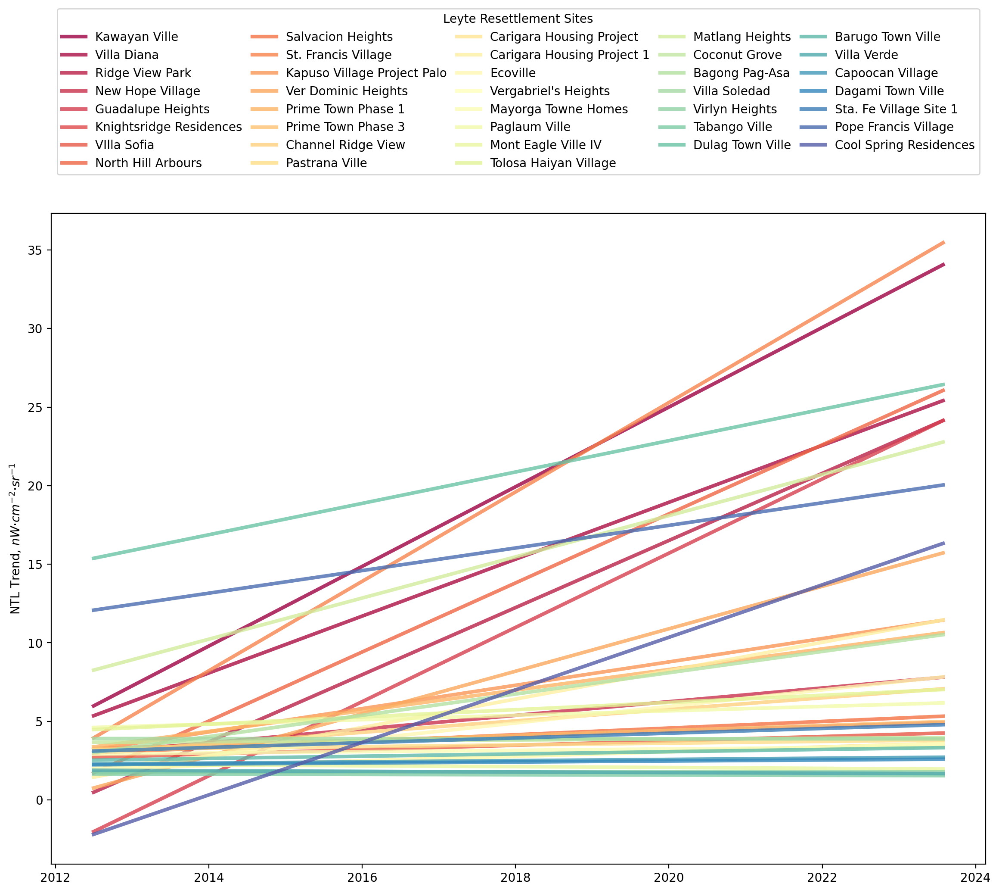

In [232]:
# fig, ax = plt.subplots(nrows=4,ncols=1, sharex='col',
#                   gridspec_kw={'height_ratios':[2,2,1.5,1.5]},
#                   figsize=(14,10), dpi = 200)
plt.figure(figsize=(14,10), dpi = 200)

for province in tqdm(select_provinces[:1]):
    print('Province: ' + str(province))
    sites = df_resettlement.loc[df_resettlement['Province'] == province, 'Title'].dropna().unique()

    for i, site in enumerate(sites):
#         print('--- Processing ' + str(site))
        
        line_color = plt.cm.Spectral(i/len(sites))
        slope, intercept, r_value, p_value, std_err = stats_summary.loc[site]        
        plt.plot(NTL_Trend.index, intercept + slope*x, color = line_color, 
                 label=str(site), alpha = 0.8, lw = 3)
        plt.legend(fontsize=10, ncol = 5, bbox_to_anchor= (0, 1.05, 1, 0.5), loc="lower left",
            bbox_transform=plt.gca().transAxes, fancybox = True, mode='expand', 
            title = str(province) + ' Resettlement Sites')
        
plt.ylabel('NTL Trend, $nW ·cm^{−2}·sr^{−1}$')        
dtFmt = mdates.DateFormatter('%Y') # define the formatting
plt.gca().xaxis.set_major_formatter(dtFmt) # apply the format to the desired axis

Province: Leyte


ValueError: x and y must have same first dimension, but have shapes (4047,) and (4411,)

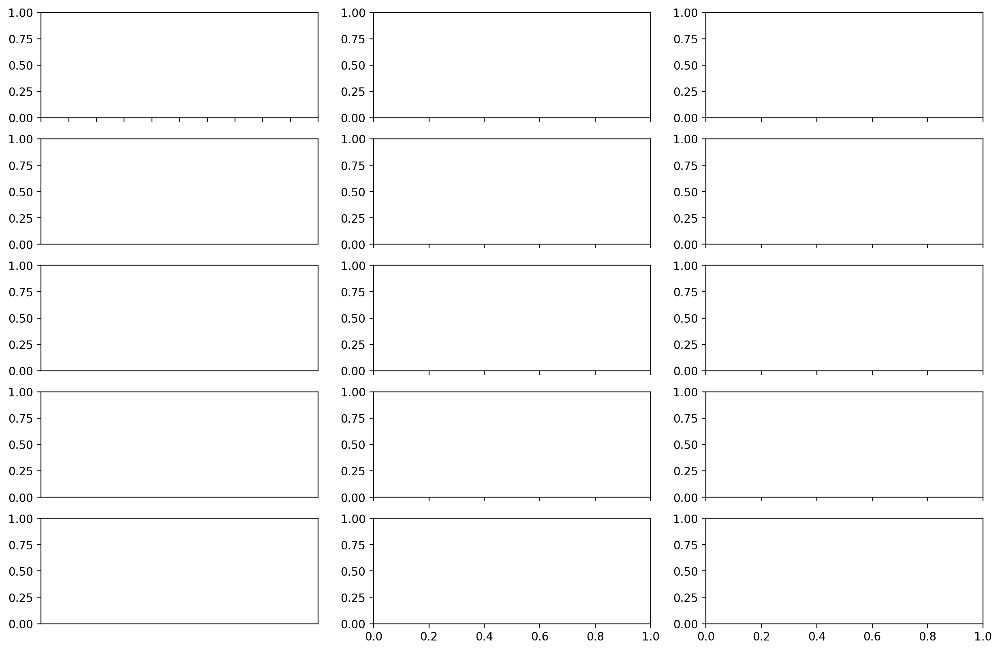

In [204]:
fig, axes = plt.subplots(nrows=5,ncols=3, sharex='col', figsize=(15,10), dpi = 200)

for p, ax in enumerate(axes.ravel()):
# for province in tqdm(select_provinces[:1]):
    province = select_provinces[p]
    print('Province: ' + str(province))
    sites = df_resettlement.loc[df_resettlement['Province'] == province, 'Title'].dropna().unique()

    for i, site in enumerate(sites):
#         print('--- Processing ' + str(site))
        
        line_color = plt.cm.Spectral(i/len(sites))
        slope, intercept, r_value, p_value, std_err = stats_summary.loc[site]        
        ax.plot(NTL_Trend.index, intercept + slope*x, color = line_color, 
                 label=str(site), alpha = 0.8, lw = 3)
        ax.set_title(str(province))
#         plt.legend(fontsize=10, ncol = 5, bbox_to_anchor= (0, 1.05, 1, 0.5), loc="lower left",
#             bbox_transform=plt.gca().transAxes, fancybox = True, mode='expand', 
#             title = str(province) + ' Resettlement Sites')
        
plt.ylabel('NTL Trend, $nW ·cm^{−2}·sr^{−1}$')        
dtFmt = mdates.DateFormatter('%Y') # define the formatting
plt.gca().xaxis.set_major_formatter(dtFmt) # apply the format to the desired axis

In [195]:
len(select_provinces)

14